### Credit_default

- limit_balance: Amount of given credit in NT dollars (includes individual and family/supplementary credit
- sex: Gender (1=male, 2=female)
- education_level: Education Level
- marital_status: Marital status (1=married, 2=single, 3=others)
- age: Age in years
- pay_0: Repayment status in September, 2005 (-1=pay duly, 1=payment delay for one month, 2=payment delay for two months, ... - - 8=payment delay for eight months, 9=payment delay for nine months and above)
- pay_2: Repayment status in August, 2005 (scale same as above)
- pay_3: Repayment status in July, 2005 (scale same as above)
- pay_4: Repayment status in June, 2005 (scale same as above)
- pay_5: Repayment status in May, 2005 (scale same as above)
- pay_6: Repayment status in April, 2005 (scale same as above)
- bill_amt_1: Amount of bill statement in September, 2005 (NT dollar)
- bill_amt_2: Amount of bill statement in August, 2005 (NT dollar)
- bill_amt_3: Amount of bill statement in July, 2005 (NT dollar)
- bill_amt_4: Amount of bill statement in June, 2005 (NT dollar)
- bill_amt_5: Amount of bill statement in May, 2005 (NT dollar)
- bill_amt_6: Amount of bill statement in April, 2005 (NT dollar)
- pay_amt_1: Amount of previous payment in September, 2005 (NT dollar)
- pay_amt_2: Amount of previous payment in August, 2005 (NT dollar)
- pay_amt_3: Amount of previous payment in July, 2005 (NT dollar)
- pay_amt_4: Amount of previous payment in June, 2005 (NT dollar)
- pay_amt_5: Amount of previous payment in May, 2005 (NT dollar)
- pay_amt_6: Amount of previous payment in April, 2005 (NT dollar)
- default_payment_next_month: Default payment (1=yes, 0=no)

In [1]:
# ! pip install plotly

In [2]:
%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [3]:
import seaborn as sns
import warnings
import plotly.graph_objs as go
import pickle
import os.path
from googleapiclient.discovery import build
from google_auth_oauthlib.flow import InstalledAppFlow
from google.auth.transport.requests import Request
from plotly.offline import init_notebook_mode, iplot
from plotly import tools
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder

In [4]:
warnings.filterwarnings("ignore")

In [5]:
def google_sheets():
    '''
    This function is responsible for providing access to google sheets.
    '''
    creds = None
    
    # The file token.pickle stores the user's access and refresh tokens, and is
    # created automatically when the authorization flow completes for the first
    # time.
    if os.path.exists('token.pickle'):
        with open('token.pickle', 'rb') as token:
            creds = pickle.load(token)
    
    # If modifying these scopes, delete the file token.pickle.
    SCOPES = ['https://www.googleapis.com/auth/spreadsheets.readonly']
    
    # If there are no (valid) credentials available, let the user log in.
    if not creds or not creds.valid:
        if creds and creds.expired and creds.refresh_token:
            creds.refresh(Request())
        else:
            flow = InstalledAppFlow.from_client_secrets_file(
                './data/google_sheets_credentials.json', SCOPES)
            creds = flow.run_local_server(port=0)
        # Save the credentials for the next run
        with open('token.pickle', 'wb') as token:
            pickle.dump(creds, token)

    service = build('sheets', 'v4', credentials=creds)
    sheet = service.spreadsheets()
    return service,sheet

def google_sheets_out(sheet, SAMPLE_SPREADSHEET_ID, SAMPLE_RANGE_NAME):
    '''
    Get table from google sheet
    '''
    
    return sheet.values().get(spreadsheetId=SAMPLE_SPREADSHEET_ID, range=SAMPLE_RANGE_NAME).execute().get('values', [])

In [6]:
import pandas as pd

# data load
service,sheet = google_sheets()

SAMPLE_SPREADSHEET_ID = '1MdEXmHiZp9J1ZILQCp6gtsw6nVKiH1JuG-0hCeVJqZQ'
SAMPLE_RANGE_NAME = "'bigquery_select'!A:X" 
out_sheet= google_sheets_out(sheet,SAMPLE_SPREADSHEET_ID,SAMPLE_RANGE_NAME)

credit_df = pd.DataFrame(np.array(out_sheet)[1:, :], columns=np.array(out_sheet)[0, :])
credit_df.head()

,bill_amt_1,bill_amt_2,bill_amt_3,bill_amt_4,bill_amt_5,bill_amt_6,limit_balance,degree,pay_0,pay_2,...,pay_amt_1,pay_amt_2,pay_amt_3,pay_amt_4,pay_amt_5,pay_amt_6,sex,marital_status,age,default_payment_next_month
0,20867,20168,14464,3455,0,0,180000,university,1,4,...,0,0,0,0,0,0,2,1,29,0
1,96343,93959,91624,96190,95233,97760,110000,university,-1,4,...,0,0,7000,1500,4200,3500,2,1,25,1
2,9787,-1256,65064,66102,54275,51791,110000,university,1,1,...,5,68500,3114,4016,2000,2000,2,1,24,0
3,24386,23744,23090,22436,26886,30858,30000,university,1,4,...,0,0,0,5000,5000,0,1,2,26,0
4,46750,45734,44741,43562,44039,45008,50000,university,5,4,...,0,0,0,1262,1358,1275,1,2,32,0


In [7]:
credit_df[credit_df.isin(['unknown', '?', ''])] = np.nan

In [8]:
credit_df[credit_df.columns[0:7]] = credit_df[credit_df.columns[0:7]].astype(int)
credit_df[credit_df.columns[8:]] = credit_df[credit_df.columns[8:]].astype(int)

In [9]:
credit_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   bill_amt_1                  30000 non-null  int32 
 1   bill_amt_2                  30000 non-null  int32 
 2   bill_amt_3                  30000 non-null  int32 
 3   bill_amt_4                  30000 non-null  int32 
 4   bill_amt_5                  30000 non-null  int32 
 5   bill_amt_6                  30000 non-null  int32 
 6   limit_balance               30000 non-null  int32 
 7   degree                      29655 non-null  object
 8   pay_0                       30000 non-null  int32 
 9   pay_2                       30000 non-null  int32 
 10  pay_3                       30000 non-null  int32 
 11  pay_4                       30000 non-null  int32 
 12  pay_5                       30000 non-null  int32 
 13  pay_6                       30000 non-null  in

In [10]:
Missing_df = pd.DataFrame(credit_df.isnull().sum() / credit_df.count())

# rename and sort by column
Missing_df.columns = ['missing_ratio']
Missing_df = Missing_df.sort_values(by=['missing_ratio'], ascending=False)

Missing_df[Missing_df.missing_ratio > 0]

,missing_ratio
degree,0.011634


In [11]:
from pandas_profiling import ProfileReport
profile = ProfileReport(credit_df, title='Pandas Profiling Report', html={'style':{'full_width':True}})

In [12]:
profile

In [13]:
# 'marital_status' - 3,0 - other


## Data Preprocessing

In [14]:
def plot_bar_chart_by_outcome(var_name, outcome , df):
    """
    Function plots the bar plot of the ratio of variable grouped by the outcome."""
    # get the size of each combination of var_name and outcome 
    temp_df = pd.DataFrame(df.groupby([outcome, var_name]).size())
    temp_df = temp_df.reset_index(drop=False)
    temp_df.rename(columns={0: 'count'}, inplace=True)
    
    # get the total amount of var_name observations
    total_count_df = temp_df.groupby(var_name, as_index=False)[['count']].sum()
    total_count_df.rename(columns={'count': 'total_count'}, inplace=True)

    # combine two tables together
    temp_df = temp_df.merge(
        total_count_df, 
        how='left')
    
    # calculate the ratio
    temp_df['ratio'] = (temp_df['count'] / temp_df['total_count']).apply(lambda x: round(x, 3))
    
    # create a plot
    trace1 = go.Bar(
        x=temp_df['ratio'][temp_df[outcome] == 0],
        y=temp_df[var_name][temp_df[outcome] == 0],
        text=temp_df['count'][temp_df[outcome] == 0].apply(lambda x: str(x) + ' observations'),
        name='No',
        orientation = 'h',
        marker=dict(color='rgba(255, 80, 80, 0.8)'),
        legendgroup='No'
    )

    trace2 = go.Bar(
        x=temp_df['ratio'][temp_df[outcome] == 1],
        y=temp_df[var_name][temp_df[outcome] == 1],
        text=temp_df['count'][temp_df[outcome] == 1].apply(lambda x: str(x) + ' observations'),
        name='Yes',
        orientation = 'h',    
        marker=dict(color='rgba(153, 255, 102, 0.8)'),
        legendgroup='Yes'
    )

    layout = go.Layout(
        height=400,
        width=800,
        barmode='stack',
        title=f'Ratio of {var_name} by {outcome}',
        xaxis={'title': 'Ratio'},
        yaxis={'title': var_name}
    )

    data = [trace1, trace2]
    fig = go.Figure(data, layout)

    iplot(fig)

### Miss cleaning

#### Degree

In [15]:
credit_df.degree.unique()

array(['university', 'high school', 'graduate school', nan, 'others'],
      dtype=object)

### SVD

In [16]:
# SVD that finds missing values via expectation-maximization

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.sparse.linalg import svds
from sklearn.metrics import r2_score
from functools import partial

def emsvd(Y, k=None, learning_rate=1, tol=1E-3, max_iter=None,     
          early_stopping=False, validation_fraction=0.1,
          verbose=True):
    """
    Approximate SVD on data with missing values via expectation-maximization

    Inputs:
    -----------
    Y:          (nobs, ndim) data matrix, missing values denoted by NaN/Inf
    k:          number of singular values/vectors to find (default: k=ndim)
    learning_rate: controls the step-size in updating missed values.
    tol:        convergence tolerance on change in R2
    max_iter:   maximum number of EM steps to perform (default: no limit)
    early_stopping: Whether to use early stopping to terminate training when validation score is not improving.
    validation_fraction: The proportion of training data to set aside as validation set for early stopping.
    verbose:    Whether to print progress messages to stdout.

    Returns:
    -----------
    U, s, Vt:   singular values and vectors (see np.linalg.svd and 
                scipy.sparse.linalg.svds for details)
    Y_hat:      (nobs, ndim) reconstructed data matrix
    """
    Y = np.array(Y)

    if k is None:
        svdmethod = partial(np.linalg.svd, full_matrices=False)
    else:
        svdmethod = partial(svds, k=k)

    if max_iter is None:
        max_iter = np.inf

    if early_stopping:
        Y_train, Y_valid = matrix_train_test_split(Y, validation_fraction)
    else:
        Y_train, Y_valid = Y, Y

    nan_mask_train = ~np.isfinite(Y_train)
    nan_mask_valid = ~np.isfinite(Y_valid)
    df_learning_curve = pd.DataFrame()

    # initialize the missing values to their respective column means
    mu_hat = np.nanmean(Y, axis=0, keepdims=1)
    Y_hat = np.where(~nan_mask_train, Y_train, mu_hat)

    i = 1
    valid_score_change = np.inf

    while not (i >= max_iter or valid_score_change < tol):

        # SVD on filled-in data
        U, s, Vt = svdmethod(Y_hat - mu_hat)

        # impute missing values
        Y_pred = U.dot(np.diag(s)).dot(Vt) + mu_hat
        Y_hat[nan_mask_train] = (1 - learning_rate)*Y_hat[nan_mask_train] + learning_rate*Y_pred[nan_mask_train]

        # update bias parameter
        mu_hat = Y_hat.mean(axis=0, keepdims=1)

        # test convergence using R^2 on validation set
        train_score = r2_score(Y_train[~nan_mask_train], Y_pred[~nan_mask_train])
        valid_score = r2_score(Y_valid[~nan_mask_valid], Y_pred[~nan_mask_valid])
        df_learning_curve.loc[i, "r2_score_train"] = train_score
        df_learning_curve.loc[i, "r2_score_valid"] = valid_score
        df_learning_curve.loc[i, "rmse_train"] = get_rmse(Y_train, Y_pred)
        df_learning_curve.loc[i, "rmse_valid"] = get_rmse(Y_valid, Y_pred)

        if i > 1:
            valid_score_change = ((valid_score - valid_score_prev) / valid_score_prev)
        valid_score_prev = valid_score

        i += 1

        if verbose:
            print(f"step: {i-1:>5}, validaion R^2: {valid_score:.4f}, change: {valid_score_change*100:>6.2f}%")

    return U, s, Vt, mu_hat, Y_hat, df_learning_curve

def matrix_train_test_split(Y, test_size=0.1):

    N, M = Y.shape
    mask_train = np.random.choice(
                [False, True], 
                size=N*M, 
                replace=True, 
                p=[test_size, 1 - test_size]
        ).reshape(N, M)

    Y_train, Y_test = Y.copy(), Y.copy()

    Y_train[~mask_train] = np.NaN
    Y_test[mask_train] = np.NaN

    return Y_train, Y_test

def get_r2_score(Y_true, Y_pred, plot=False):
    """calcualtes and return R2 score"""

    Y_true = np.array(Y_true)
    Y_pred = np.array(Y_pred)

    mask = np.isfinite(Y_true)
    r2 = r2_score(Y_true[mask], Y_pred[mask])

    if plot:
        plt.plot(Y_true[mask].reshape(-1), Y_pred[mask].reshape(-1), "o", markersize=1)
        plt.title(f"R2 score: {r2:.3f}")
        plt.ylabel("predicted values")
        plt.xlabel("true values")
        plt.show()

    return r2


def get_rmse(Y_true, Y_pred):
    """calcualtes and return RMSE"""
    diff = Y_true - Y_pred
    return np.sqrt(np.nanmean(diff*diff))


def get_svd_reconstruction(df_utility_matrix: pd.DataFrame, *args, **kwargs) -> pd.DataFrame:
    """Predict scores performing matrix factorization using SVD"""

    U, s, Vt, mu_hat, _, _ = emsvd(df_utility_matrix, *args, **kwargs)

    Y_pred = U.dot(np.diag(s)).dot(Vt) + mu_hat

    df_pred = pd.DataFrame(
            data=Y_pred,
            columns=df_utility_matrix.columns,
            index=df_utility_matrix.index,
        )

    return df_pred

In [17]:
Y = credit_df.replace({'others': 100, 'graduate school': 200, 'high school': 300, 'university': 400}).iloc[:,:-1].values

NUMBER_OF_LATENT_FACTORS = 15

svd_params = dict(
        k=NUMBER_OF_LATENT_FACTORS,
        learning_rate=0.5,
        tol=1E-4, 
        max_iter=None,
        early_stopping=False,
        validation_fraction=0.1,
        verbose=False
    )

U, s, Vt, mu_hat, Y_hat, df_learning_curve = emsvd(Y, **svd_params)
Y_pred = U.dot(np.diag(s)).dot(Vt) + mu_hat

print("real utility martix:\n")
print(Y.round(2))

print("\n-------\n")

print("reconstructed utility martix:\n")
print(Y_pred.round(2))

print("\n-------\n")

print(f"Reconstruction RMSE: {get_rmse(Y, Y_pred):.4f}")
print(f"Reconstruction R2 score: {get_r2_score(Y, Y_pred, plot=False):.4f}")

real utility martix:

[[ 2.0867e+04  2.0168e+04  1.4464e+04 ...  2.0000e+00  1.0000e+00
   2.9000e+01]
 [ 9.6343e+04  9.3959e+04  9.1624e+04 ...  2.0000e+00  1.0000e+00
   2.5000e+01]
 [ 9.7870e+03 -1.2560e+03  6.5064e+04 ...  2.0000e+00  1.0000e+00
   2.4000e+01]
 ...
 [ 3.9000e+02  3.9000e+02  3.6659e+04 ...  2.0000e+00  2.0000e+00
   2.5000e+01]
 [ 0.0000e+00  3.9000e+02  1.8100e+02 ...  2.0000e+00  1.0000e+00
   5.0000e+01]
 [ 3.9000e+02  3.9000e+02  3.9000e+02 ...  2.0000e+00  2.0000e+00
   4.4000e+01]]

-------

reconstructed utility martix:

[[ 2.0867e+04  2.0168e+04  1.4464e+04 ...  1.6700e+00  1.6300e+00
   2.8980e+01]
 [ 9.6343e+04  9.3959e+04  9.1624e+04 ...  1.6600e+00  1.7600e+00
   2.4990e+01]
 [ 9.7870e+03 -1.2560e+03  6.5064e+04 ...  1.6900e+00  1.7600e+00
   2.4020e+01]
 ...
 [ 3.9000e+02  3.9000e+02  3.6659e+04 ...  1.6900e+00  1.7400e+00
   2.5000e+01]
 [ 0.0000e+00  3.9000e+02  1.8100e+02 ...  1.5300e+00  1.2000e+00
   5.0000e+01]
 [ 3.9000e+02  3.9000e+02  3.9000e+

In [18]:
np.unique(Y_pred[:, 7].round(0))

array([100., 200., 300., 311., 400.])

In [19]:
squarer = lambda x : 100 * round(x/100)
vfunc = np.vectorize(squarer)
Y_pred[:,7] = vfunc(Y_pred[:,7].round(0))

In [20]:
Y_pred[:100,7].round(0)

array([400., 400., 400., 400., 400., 300., 400., 400., 200., 400., 400.,
       300., 400., 300., 300., 300., 400., 200., 300., 400., 400., 400.,
       300., 400., 400., 400., 300., 300., 400., 400., 400., 300., 200.,
       400., 400., 400., 400., 300., 400., 400., 300., 400., 400., 400.,
       300., 400., 400., 300., 400., 200., 400., 400., 400., 400., 400.,
       300., 400., 300., 400., 400., 400., 300., 400., 200., 200., 200.,
       400., 200., 300., 400., 400., 200., 400., 400., 400., 400., 400.,
       200., 200., 200., 400., 400., 400., 400., 400., 400., 300., 400.,
       300., 400., 200., 400., 400., 400., 200., 400., 400., 300., 400.,
       400.])

In [21]:
Y[:100, 7].round(0)

array([400., 400., 400., 400., 400., 300., 400., 400., 200., 400., 400.,
       300., 400., 300., 300., 300., 400., 200., 300., 400., 400., 400.,
       300., 400., 400., 400., 300., 300., 400., 400., 400., 300., 200.,
       400., 400., 400., 400., 300., 400., 400., 300., 400., 400., 400.,
       300., 400., 400., 300., 400., 200., 400., 400., 400., 400., 400.,
       300., 400., 300., 400., 400., 400., 300., 400., 200., 200., 200.,
       400., 200., 300., 400., 400., 200., 400., 400., 400., 400., 400.,
       200., 200., 200., 400., 400., 400., 400., 400., 400., 300., 400.,
       300., 400., 200., 400., 400., 400., 200., 400., 400., 300., 400.,
       400.])

In [22]:
credit_df.degree = Y_pred[:,7]

In [23]:
credit_df.degree = credit_df.degree.replace({100: 'others', 200: 'graduate school', 300: 'high school', 400: 'university'})

In [24]:
credit_df.degree.isnull().sum() / credit_df.degree.count()

0.0

In [25]:
plot_bar_chart_by_outcome('degree', 'default_payment_next_month' , credit_df)

### Outlier finding

In [26]:
credit_df.head()

,bill_amt_1,bill_amt_2,bill_amt_3,bill_amt_4,bill_amt_5,bill_amt_6,limit_balance,degree,pay_0,pay_2,...,pay_amt_1,pay_amt_2,pay_amt_3,pay_amt_4,pay_amt_5,pay_amt_6,sex,marital_status,age,default_payment_next_month
0,20867,20168,14464,3455,0,0,180000,university,1,4,...,0,0,0,0,0,0,2,1,29,0
1,96343,93959,91624,96190,95233,97760,110000,university,-1,4,...,0,0,7000,1500,4200,3500,2,1,25,1
2,9787,-1256,65064,66102,54275,51791,110000,university,1,1,...,5,68500,3114,4016,2000,2000,2,1,24,0
3,24386,23744,23090,22436,26886,30858,30000,university,1,4,...,0,0,0,5000,5000,0,1,2,26,0
4,46750,45734,44741,43562,44039,45008,50000,university,5,4,...,0,0,0,1262,1358,1275,1,2,32,0


#### Marital status

In [27]:
plot_bar_chart_by_outcome('marital_status', 'default_payment_next_month' , credit_df)

In [28]:
'''
Since we do not know what the status '0' is and the number of such observations is small,
we will drop them from the dataset.
'''
credit_df = credit_df[credit_df.marital_status != 0]

In [29]:
data_features = credit_df.copy()

In [30]:
col_ignore = ['sex', 'degree', 'marital_status', 'default_payment_next_month']
data_features.drop(columns=col_ignore, inplace=True)

In [31]:
scaler = StandardScaler()
scaled_data = pd.DataFrame(
    data=scaler.fit_transform(data_features), 
    columns=data_features.columns
)

In [32]:
def anomalies_report(outliers):
    
    print("Total number of outliers: {}\nPercentage of outliers:   {:.2f}%".format(
            sum(outliers), 100*sum(outliers)/len(outliers))) 

#### DBSCAN

In [33]:
from sklearn.cluster import DBSCAN

outlier_percentage = 1.

num_clusters = []
anomaly_percentage = []

eps = 1.7
eps_history = [eps]
while outlier_percentage > 0.1:    
    model = DBSCAN(eps=eps).fit(scaled_data)
    labels = model.labels_
    num_clusters.append(len(np.unique(labels)) - 1)
    labels = np.array([1 if label == -1 else 0 for label in labels])
    outlier_percentage = sum(labels==1) / len(labels)    
    eps += 0.05
    eps_history.append(eps)
    anomaly_percentage.append(outlier_percentage)
    print(outlier_percentage, eps)
    
model = DBSCAN(eps)
model.fit(scaled_data)
density_outlier = np.array([1 if label == -1 else 0 for label in model.labels_])

0.09727509517130835 1.75


#### HDBSCAN

In [34]:
from hdbscan import HDBSCAN

clusterer = HDBSCAN(min_cluster_size=50).fit(scaled_data)

threshold = pd.Series(clusterer.outlier_scores_).quantile(0.9)
hdb_outliers = np.array([1 if i > threshold else 0 for i in clusterer.outlier_scores_])

#### SVM

In [35]:
from sklearn.svm import OneClassSVM

one_class_svm = OneClassSVM(nu=0.1, gamma='auto')
one_class_svm.fit(scaled_data)
svm_outliers = one_class_svm.predict(scaled_data)
svm_outliers = np.array([1 if label == -1 else 0 for label in svm_outliers])

#### IsolationForest

In [36]:
from sklearn.ensemble import IsolationForest

isolation_forest = IsolationForest(n_estimators=100, contamination=0.1, 
                                   max_features=1.0, bootstrap=True, behaviour="new")
isolation_forest.fit(scaled_data)

isolation_outliers = isolation_forest.predict(scaled_data)
isolation_outliers = np.array([1 if label == -1 else 0 for label in isolation_outliers])

In [37]:
anomalies_report(isolation_outliers)

Total number of outliers: 2995
Percentage of outliers:   10.00%


### All methods

In [38]:
summary = np.concatenate((
    [density_outlier],
    [hdb_outliers],
    [svm_outliers],
    [isolation_outliers]
))

summary = pd.DataFrame(
    summary.T, 
    columns=['dbscan', 'hdbscan', 'svm', 'isolation']
)
summary.head()

,dbscan,hdbscan,svm,isolation
0,1,0,1,0
1,1,0,1,1
2,0,0,0,0
3,0,0,1,0
4,0,0,1,0


In [39]:
outliers_score_model_based = summary.sum(axis=1)

In [40]:
outliers_score_model_based.value_counts()/ len(outliers_score_model_based)

0    0.761537
1    0.151072
3    0.041441
2    0.033861
4    0.012088
dtype: float64

In [41]:
corr_matrix = credit_df.corr()
lower = corr_matrix.where(np.tril(np.ones(corr_matrix.shape), k=-1).astype(np.bool))

high_corr = [
    column for column in lower.columns if any((lower[column] > 0.6)|(lower[column] < -0.6))
]

other_features = [col for col in credit_df.columns if col not in high_corr and col not in col_ignore]

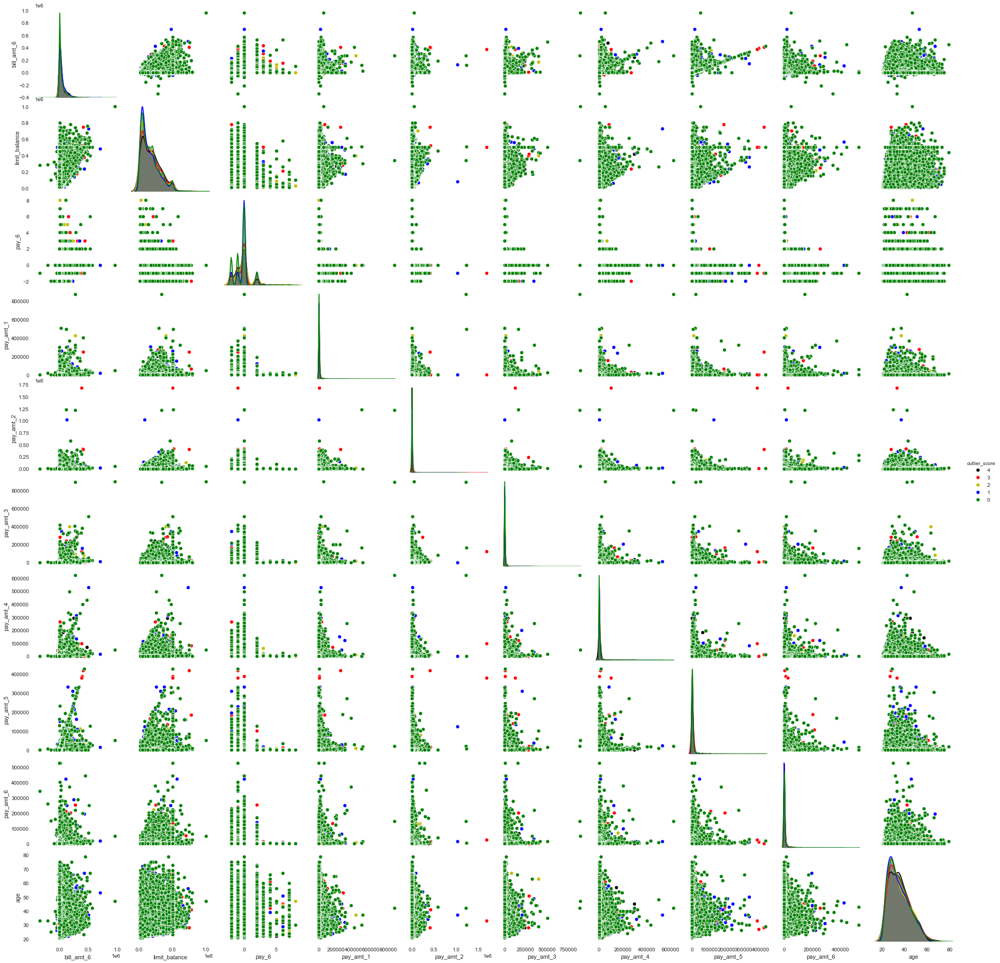

In [42]:
labeled_data = data_features.copy()
labeled_data['outlier_score'] = outliers_score_model_based

custom_palette = {0:'g', 1:'b', 2:'y', 3:'r', 4:'black'}
sns.distributions._has_statsmodels = False

sns.pairplot(data=labeled_data, vars=other_features, 
             hue='outlier_score',
             hue_order=[4, 3, 2, 1, 0],
             palette=custom_palette
)


Drop rows where outliers_score == 3. It is 4% our dataset

In [43]:
credit_df.reset_index(inplace=True)
credit_df['outliers_score'] = outliers_score_model_based
credit_df = credit_df.loc[lambda x: x.outliers_score !=3].reset_index()
credit_df.drop(columns='outliers_score', inplace=True)

In [44]:
credit_df.head()

,level_0,index,bill_amt_1,bill_amt_2,bill_amt_3,bill_amt_4,bill_amt_5,bill_amt_6,limit_balance,degree,...,pay_amt_1,pay_amt_2,pay_amt_3,pay_amt_4,pay_amt_5,pay_amt_6,sex,marital_status,age,default_payment_next_month
0,0,0,20867,20168,14464,3455,0,0,180000,university,...,0,0,0,0,0,0,2,1,29,0
1,2,2,9787,-1256,65064,66102,54275,51791,110000,university,...,5,68500,3114,4016,2000,2000,2,1,24,0
2,3,3,24386,23744,23090,22436,26886,30858,30000,university,...,0,0,0,5000,5000,0,1,2,26,0
3,4,4,46750,45734,44741,43562,44039,45008,50000,university,...,0,0,0,1262,1358,1275,1,2,32,0
4,6,7,19276,18691,18048,18553,19465,16523,20000,university,...,0,0,1000,1400,0,3000,1,2,26,0


### Corelation

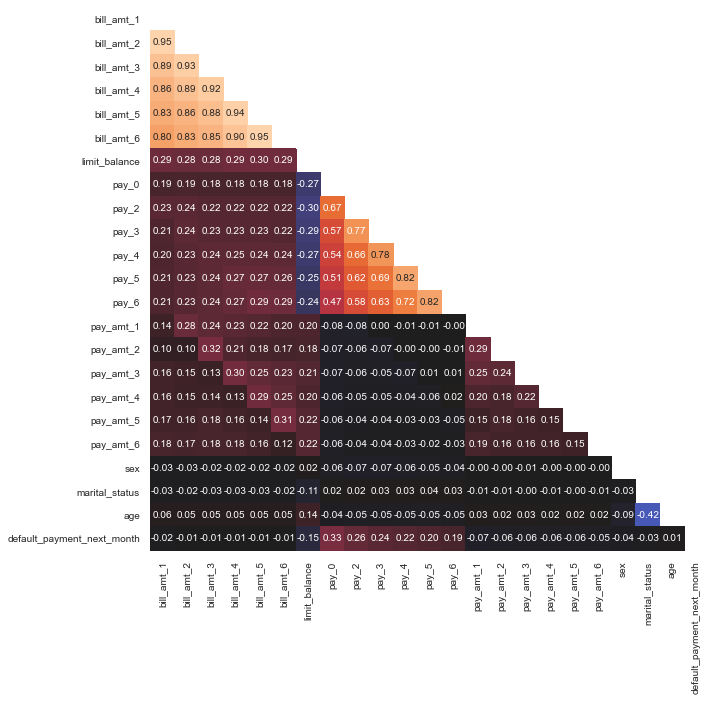

In [45]:
plt.figure(figsize=(10,10))
sns.heatmap(lower, annot=True, fmt='.2f', cbar=False, center=0)

'bill_amt_*' and 'pay_*' have high correlation. 

In [46]:
credit_df.default_payment_next_month.value_counts()

0    22321
1     6384
Name: default_payment_next_month, dtype: int64

In [47]:
default_payment_no = credit_df.loc[lambda x: x.default_payment_next_month == 0]
default_payment_yes = credit_df.loc[lambda x: x.default_payment_next_month == 1]

In [48]:
diff_int = round(default_payment_no.shape[0] / default_payment_yes.shape[0])
diff_float = round(default_payment_no.shape[0] / default_payment_yes.shape[0], 1) - diff_int

In [49]:
credit_df = default_payment_no.append([default_payment_yes]*diff_int, ignore_index=True)
credit_df = credit_df.append(default_payment_yes[:int(default_payment_yes.shape[0]*diff_float)], 
                          ignore_index=True)

credit_df.default_payment_next_month.value_counts()

1    22344
0    22321
Name: default_payment_next_month, dtype: int64

In [50]:
credit_df.to_csv('./data/credit.csv', index=False)

### Encoding

In [46]:
credit_df_onehot = pd.get_dummies(credit_df[['degree']], prefix_sep='_')
credit_df_scaled = credit_df.join(credit_df_onehot)
credit_df_scaled.drop(columns=['degree'], inplace=True)

In [47]:
std_scaler = StandardScaler()
credit_df_scaled.iloc[:,:-5] = std_scaler.fit_transform(credit_df_scaled.iloc[:,:-5])

In [48]:
credit_df_scaled.head()

,level_0,index,bill_amt_1,bill_amt_2,bill_amt_3,bill_amt_4,bill_amt_5,bill_amt_6,limit_balance,pay_0,...,pay_amt_5,pay_amt_6,sex,marital_status,age,default_payment_next_month,degree_graduate school,degree_high school,degree_others,degree_university
0,-1.732273,-1.732011,-0.566171,-0.726859,0.342347,0.443190,0.305985,0.293558,-0.410678,0.932564,...,-0.150843,-0.158599,0.806170,-1.074388,-1.238349,0,0,0,0,1
1,-1.732157,-1.731895,-0.348184,-0.339023,-0.323336,-0.300463,-0.187689,-0.091758,-1.048194,0.932564,...,0.084083,-0.283917,-1.240432,0.854696,-1.020526,0,0,0,0,1
2,-1.732041,-1.731780,-0.014253,0.002119,0.020036,0.059323,0.121486,0.168702,-0.888815,4.587896,...,-0.201117,-0.204027,-1.240432,0.854696,-0.367057,0,0,0,0,1
3,-1.731809,-1.731433,-0.424485,-0.417412,-0.403299,-0.366592,-0.321449,-0.355623,-1.127883,0.932564,...,-0.307461,-0.095940,-1.240432,0.854696,-1.020526,0,0,0,0,1
4,-1.731694,-1.731317,6.411482,6.582124,6.628037,7.022111,7.324408,7.389745,2.776900,7.329396,...,-0.307461,0.593309,0.806170,0.854696,0.504234,1,1,0,0,0


Use the PCA for lunching heavily mutating features. 

#### PCA

In [49]:
credit_df_scaled.iloc[:, 2:8].columns

Index(['bill_amt_1', 'bill_amt_2', 'bill_amt_3', 'bill_amt_4', 'bill_amt_5',
       'bill_amt_6'],
      dtype='object')

In [50]:
credit_df_scaled.iloc[:, 9:15].columns

Index(['pay_0', 'pay_2', 'pay_3', 'pay_4', 'pay_5', 'pay_6'], dtype='object')

In [51]:
from sklearn.decomposition import PCA

pca_bill_amt = PCA(0.9)
pca_pay = PCA(0.85)

bill_amt = pca_bill_amt.fit_transform(credit_df_scaled.iloc[:, 2:8])
for i in range(bill_amt.shape[1]):
    credit_df_scaled[f'bill_amt_pca_{i}'] = bill_amt[:,i]

pay = pca_pay.fit_transform(credit_df_scaled.iloc[:, 9:15])
for i in range(pay.shape[1]):
    credit_df_scaled[f'pay_pca_{i}'] = pay[:,i]
credit_df_scaled.drop(columns=list(credit_df_scaled.iloc[:, 2:8].columns) + list(credit_df_scaled.iloc[:, 9:15].columns),
                      inplace=True)

In [52]:
credit_df_scaled.head()

,level_0,index,limit_balance,pay_amt_1,pay_amt_2,pay_amt_3,pay_amt_4,pay_amt_5,pay_amt_6,sex,...,age,default_payment_next_month,degree_graduate school,degree_high school,degree_others,degree_university,bill_amt_pca_0,pay_pca_0,pay_pca_1,pay_pca_2
0,-1.732273,-1.732011,-0.410678,-0.332002,2.939189,-0.090393,-0.008440,-0.150843,-0.158599,0.806170,...,-1.238349,0,0,0,0,1,0.042805,0.722921,-0.702588,-0.737489
1,-1.732157,-1.731895,-1.048194,-0.332338,-0.236989,-0.280829,0.062325,0.084083,-0.283917,-1.240432,...,-1.020526,0,0,0,0,1,-0.649904,6.150854,0.529218,0.639598
2,-1.732041,-1.731780,-0.888815,-0.332338,-0.236989,-0.280829,-0.206498,-0.201117,-0.204027,-1.240432,...,-0.367057,0,0,0,0,1,0.145787,5.235723,-4.098271,0.236097
3,-1.731809,-1.731433,-1.127883,-0.332338,-0.236989,-0.219674,-0.196573,-0.307461,-0.095940,-1.240432,...,-1.020526,0,0,0,0,1,-0.934077,5.821517,0.140890,1.124642
4,-1.731694,-1.731317,2.776900,-0.332338,-0.236989,-0.280829,-0.297256,-0.307461,0.593309,0.806170,...,0.504234,1,1,0,0,0,16.884481,12.043445,-4.110063,-0.375505


We need to balance the targeting data. Let's duplicate the observational data with 'default_payment_next_month' = 1

In [57]:
credit_df_scaled.to_csv('./data/credit_scaled.csv', index=False)